# Preprocessing (prétraitement des données)

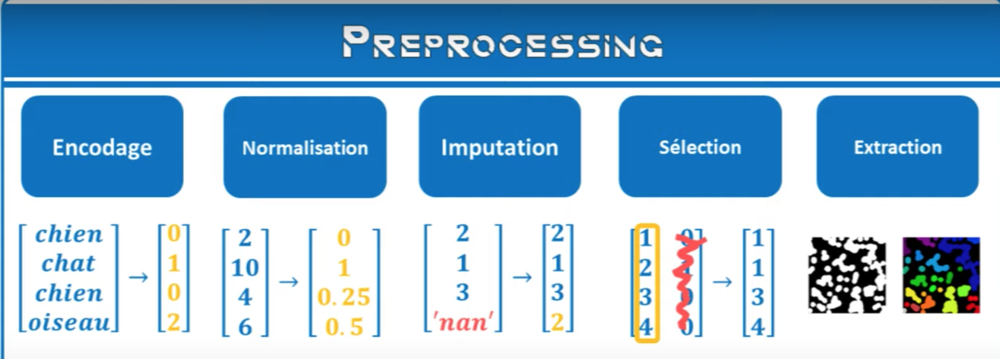

comme on peut le voir quand on a des données maquantes ou pas traitable dans l'état(text, image, 'nan' ...) Il faut uniformiser le dataset

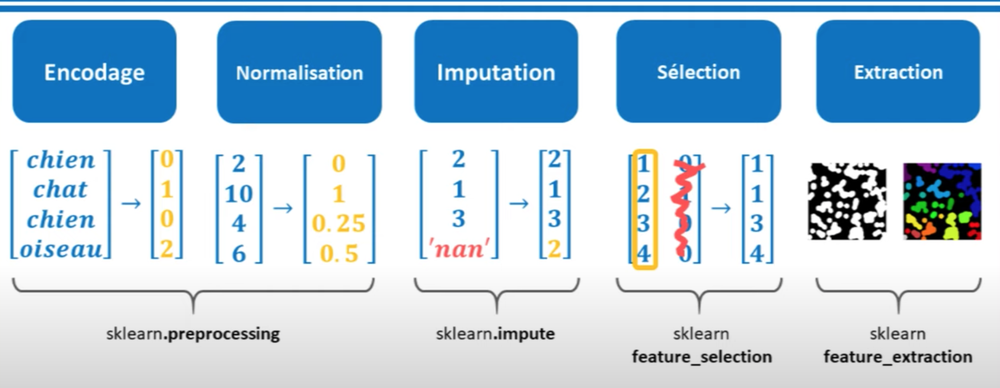

sklearn a développé des modules pour cela

## sklearn.preprocessing

 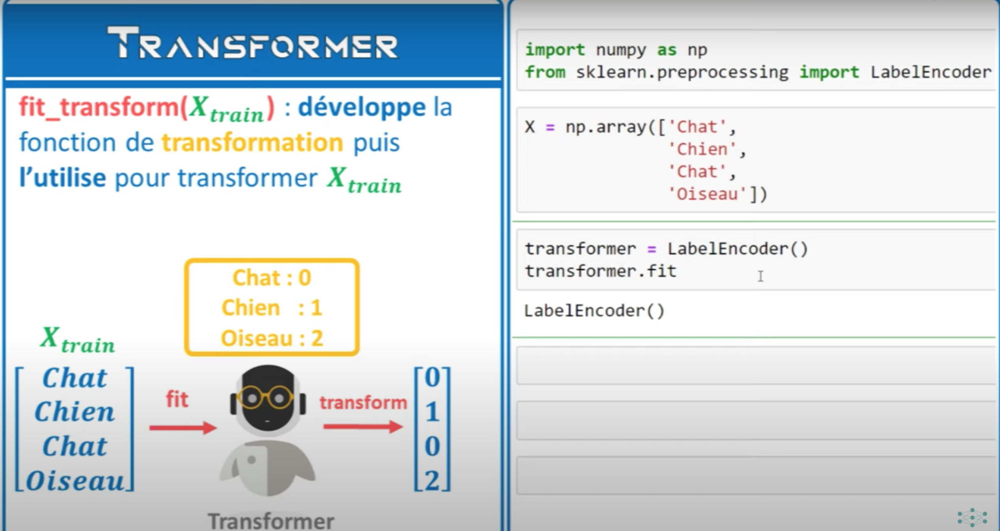

avec les données du train set on développe une function de transformation ce qui permet ensuite de traiter nos données pour entrainer un estimateur.

Une fois terminé pour le train set on utilise le même pour le test set pour transformer et estimer

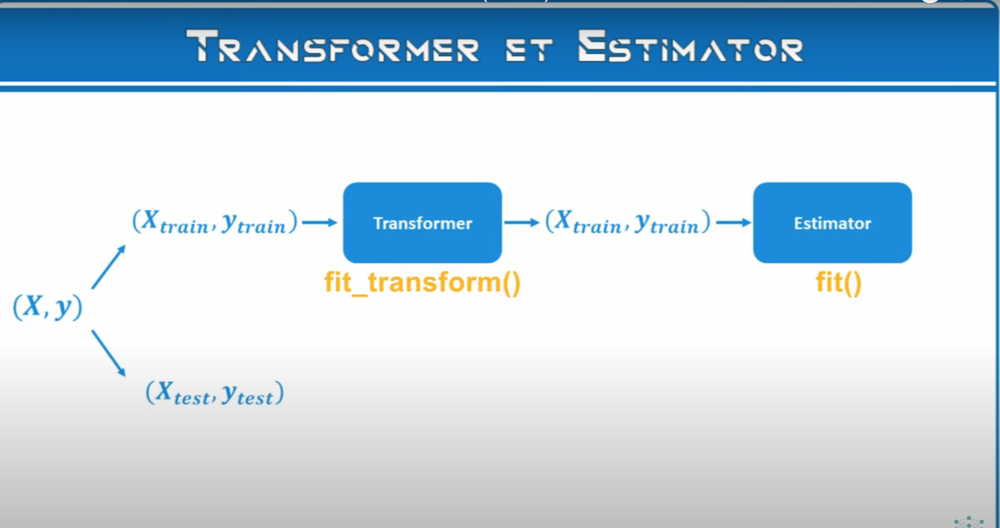

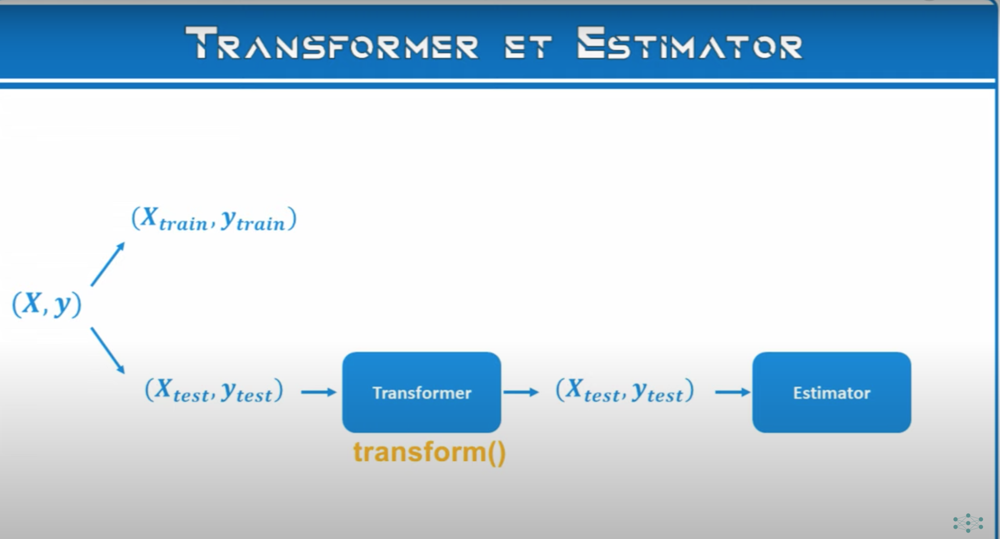

c'est ce qu'on va appeler un Pipeline(une chaîne de transformation).

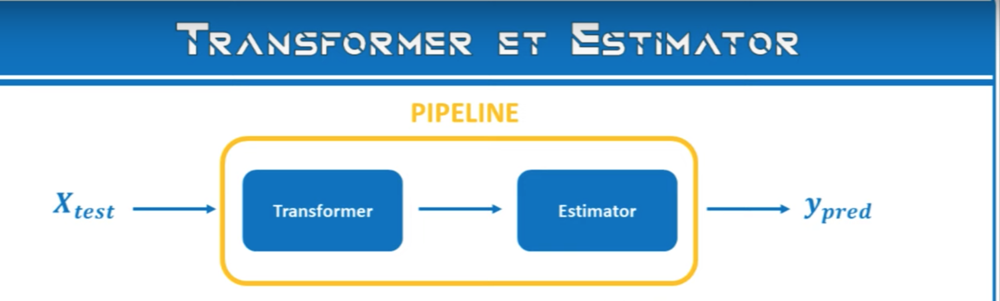

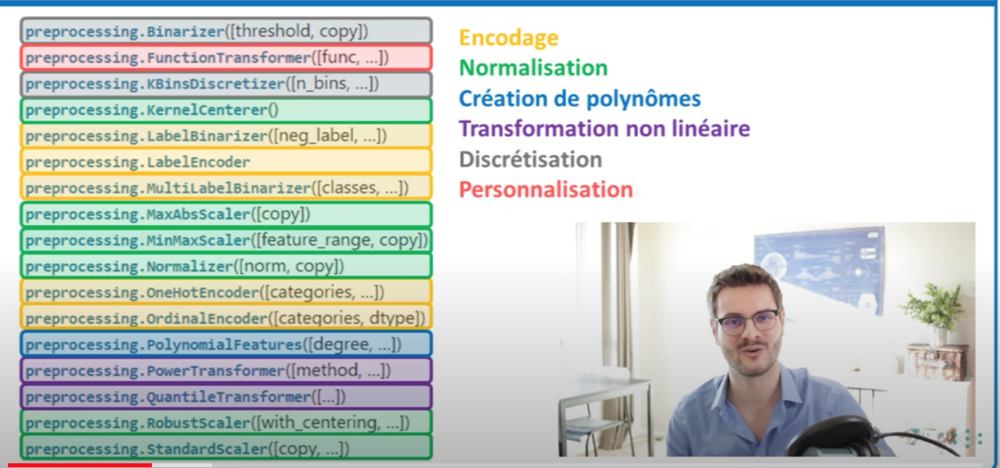

# Encodage

convertir les données texte en données numérique

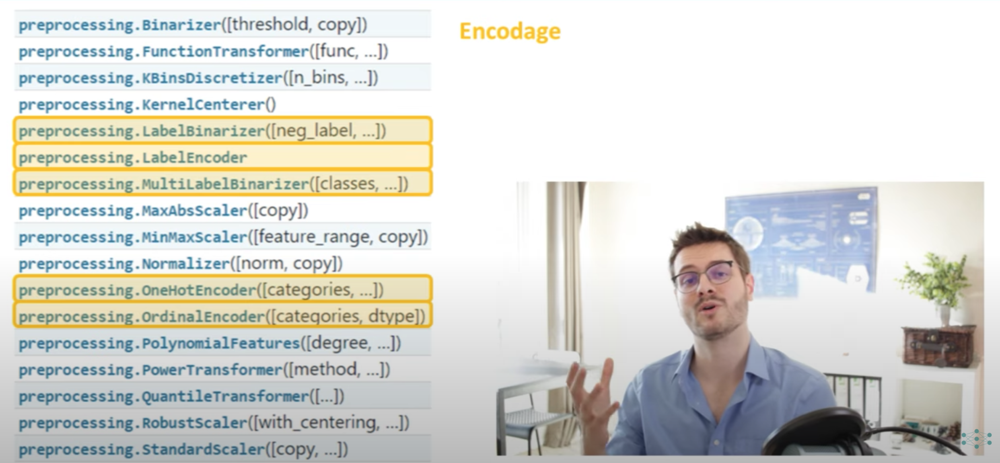

## il y'a deux type d'encodage graçe à ces encodeurs:
- l'encodage ordinal
- l'encodage one-hot

# LabelEncoder

### ne marche que pour les tableaux avec une seul dimensions qui est souvent une colonne

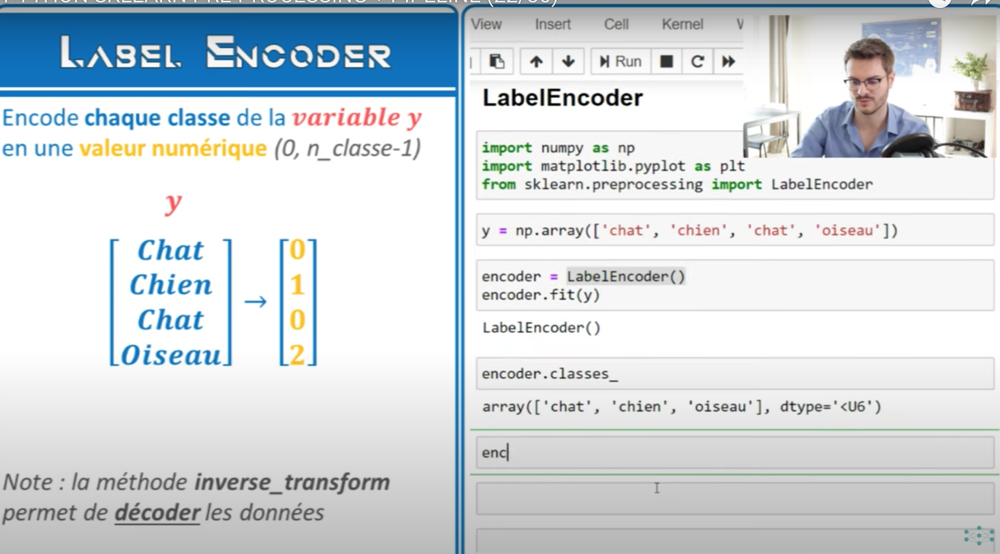

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

y = np.array(['chat', 'chien', 'chat', 'oiseau'])
encoder = LabelEncoder()
encoder.fit(y)

LabelEncoder()

In [4]:
encoder.classes_

array(['chat', 'chien', 'oiseau'], dtype='<U6')

In [12]:
e = encoder.transform(y)
print(e)

[0 1 0 2]


In [13]:
encoder.inverse_transform(e)

array(['chat', 'chien', 'chat', 'oiseau'], dtype='<U6')

In [7]:
# pour aller plus vite on peut utiliser la méthode fit_transform
encoder = LabelEncoder()
encoder.fit_transform(y)

array([0, 1, 0, 2])

In [14]:
# on peut aussi inverser comme cela
encoder.inverse_transform(np.array([0,1,2,2]))

array(['chat', 'chien', 'oiseau', 'oiseau'], dtype='<U6')

# pour un tableau X avec de multiples dimensions on utilise Ordinal Encoder

In [18]:
from sklearn.preprocessing import OrdinalEncoder

X = np.array([['Chat', 'Poils'],
             ['Chien', 'Poils'],
            ['Chat', 'Poils'],
             ['Oiseau', 'Plumes']])
encoder = OrdinalEncoder()
encoder.fit_transform(X)

array([[0., 1.],
       [1., 1.],
       [0., 1.],
       [2., 0.]])

# Label Binarizer (encodage one hot)

Déjà vu dans un précédent tuto pour le text encoding, on ne peut dire que la catégorie chat vaut mieux que la chien en lui acordant 2 au lieu de 1 comme valeur donc on va utiliser des matrices avec un encodage différent

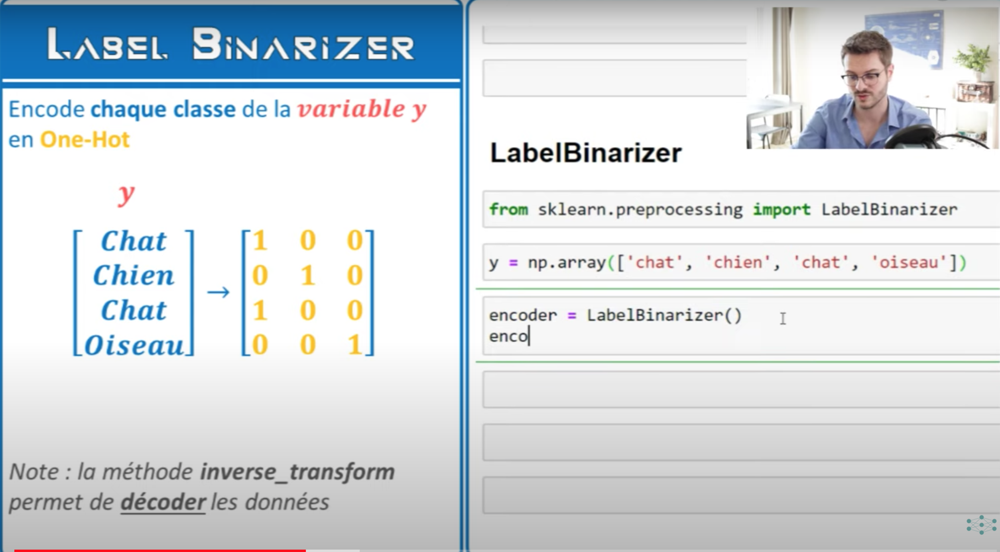

In [20]:
from sklearn.preprocessing import LabelBinarizer
y = np.array(['chat', 'chien', 'chat', 'oiseau'])

encoder = LabelBinarizer()
encoder.fit_transform(y)

array([[1, 0, 0],
       [0, 1, 0],
       [1, 0, 0],
       [0, 0, 1]])

ça va donner ce qu'on appel une matrice creuse donc qui va prendre peu de mémoire au final
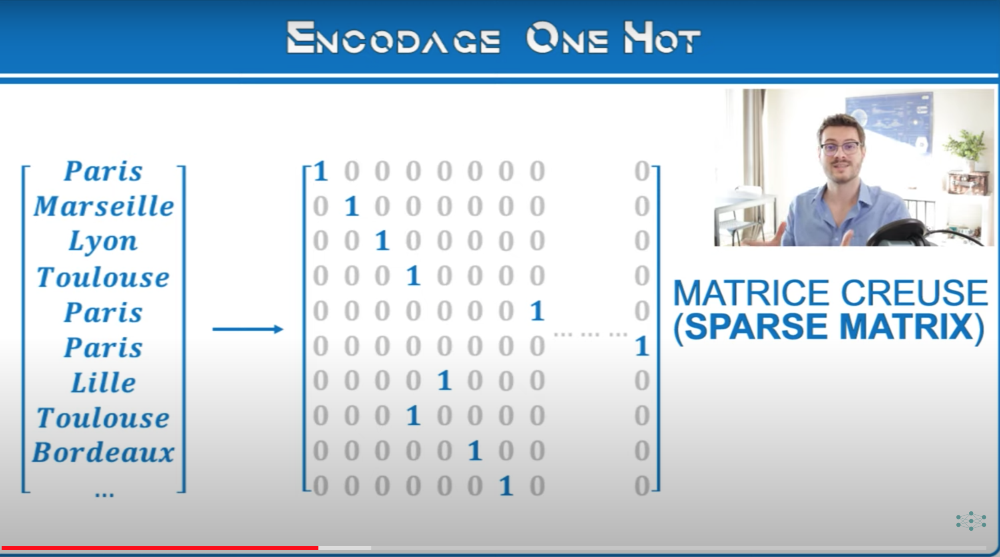

# façon de stocker cette matrice

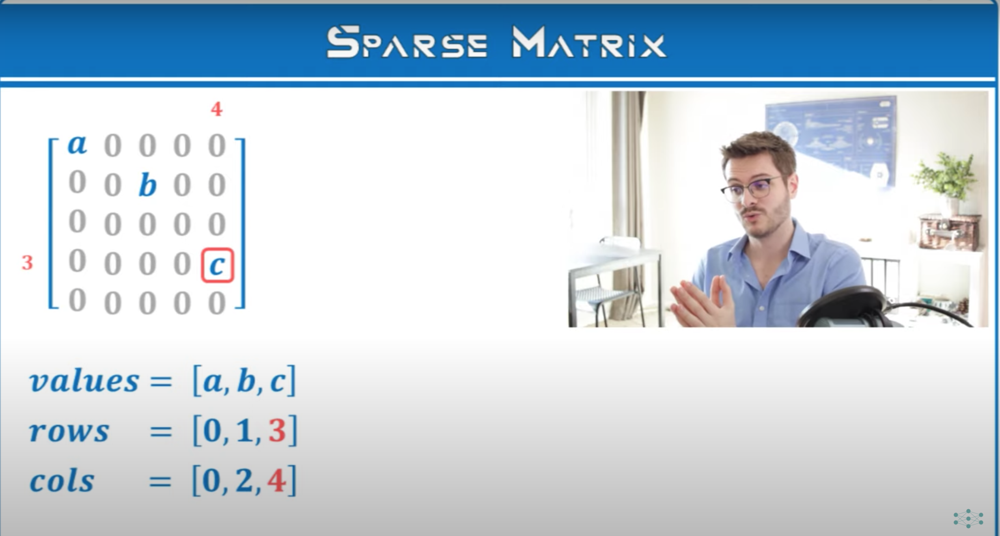

In [21]:
# donc on peut voir un résultat très compressé, pour avoir cela il faut le signifier dans LabelBinarizer

# pour compresser
encoder = LabelBinarizer(sparse_output=True)
encoder.fit_transform(y)
# on peut le voir avec l'output c'est compressé

<4x3 sparse matrix of type '<class 'numpy.int64'>'
	with 4 stored elements in Compressed Sparse Row format>

# One-Hot Encoder
utilise déjà la méthode de compression par défaut

In [22]:
from sklearn.preprocessing import OneHotEncoder
new_x = np.array([['Chat', 'Poils'],
             ['Chien', 'Poils'],
            ['Chat', 'Poils'],
             ['Oiseau', 'Plumes']])

encoder = OneHotEncoder()
encoder.fit(new_x)

OneHotEncoder(categories='auto', drop=None, dtype=<class 'numpy.float64'>,
              handle_unknown='error', sparse=True)

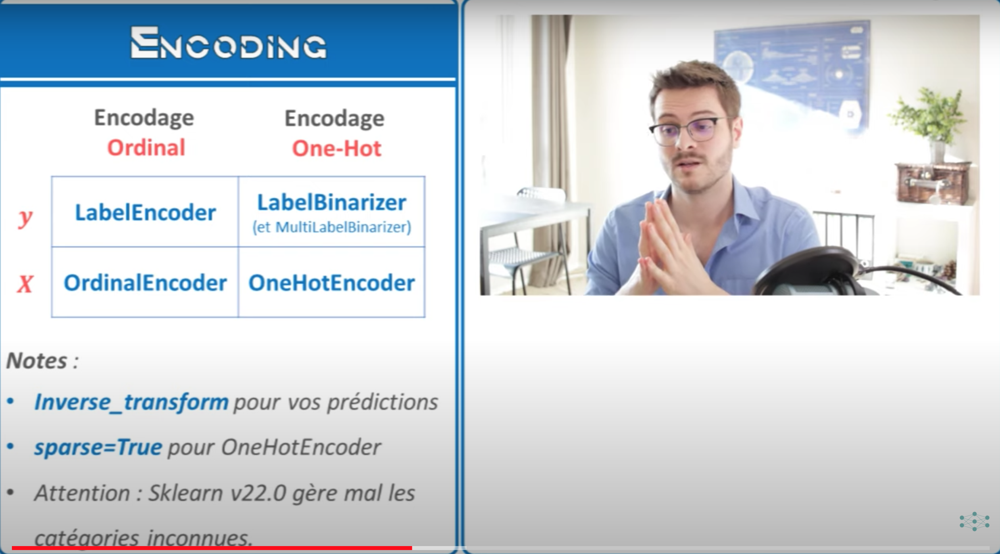

à noter que quand on ajoute une catégorie au testing set qui n'a pas été vu dans le training set alors on peut rencontrer une erreur